# Lab 06 - Object detection
### Thực hiện segmentation tất cả các đối tượng sau từ tập thư mục ảnh (tùy chọn 1 trong 5 ảnh mỗi loại)


In [1]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import threshold_otsu
from skimage.measure import label, regionprops
from skimage.segmentation import mark_boundaries
from scipy import ndimage as ndi
import pandas as pd
import json
import os
import timeit
import random

In [2]:
def ShowImage(ImageList, nRows = 1, nCols = 2, WidthSpace = 0.00, HeightSpace = 0.00):
    from matplotlib import pyplot as plt
    import matplotlib.gridspec as gridspec
    gs = gridspec.GridSpec(nRows, nCols)
    gs.update(wspace=WidthSpace, hspace=HeightSpace) # set the spacing between axes.
    plt.figure(figsize=(20,20))
    for i in range(len(ImageList)):
        ax1 = plt.subplot(gs[i])
        ax1.set_xticklabels([])
        ax1.set_yticklabels([])
        ax1.set_aspect('equal')
        plt.subplot(nRows, nCols,i+1)
        image = ImageList[i].copy()
        if (len(image.shape) < 3):
            plt.imshow(image, plt.cm.gray)
        else:
            plt.imshow(image)
        plt.title("Image " + str(i))
        plt.axis('off')
    plt.show()

In [3]:
def morphology(Mask, Size):

    from skimage.morphology import erosion, dilation, opening, closing, white_tophat
    from skimage.morphology import disk
    selem = disk(abs(Size))
    if(Size > 0):
        result = dilation(Mask, selem)
    else:
        result = erosion(Mask, selem)
    return result

In [4]:
import os

import pandas as pd
def get_subfiles(dir):
    "Get a list of immediate subfiles"
    return next(os.walk(dir))[2]

In [5]:
def SegmentColorImageByMask(IM, Mask):
    Mask = Mask.astype(np.uint8)
    result = cv2.bitwise_and(IM, IM, mask = Mask)
    return result

In [6]:
def SegmentationByOtsu(image, mask):
    image_process = image.copy()
    image_mask = mask.copy()
    image_process[image_mask == 0] = 0
    ListPixel = image_process.ravel()
    ListPixel = ListPixel[ListPixel > 0]
    from skimage.filters import threshold_otsu
    otsu_thresh = threshold_otsu(ListPixel)
    return otsu_thresh

In [7]:
def ResizeImage(IM, DesiredWidth, DesiredHeight):
    from skimage.transform import rescale, resize
    OrigWidth = float(IM.shape[1])
    OrigHeight = float(IM.shape[0])
    Width = DesiredWidth
    Height = DesiredHeight
    if((Width == 0) & (Height == 0)):
        return IM
    if(Width == 0):
        Width = int((OrigWidth * Height)/OrigHeight)
    if(Height == 0):
        Height = int((OrigHeight * Width)/OrigWidth)
    dim = (Width, Height)
    # print(dim)
    resizedIM = cv2.resize(IM, dim, interpolation = cv2.INTER_NEAREST)
    # imshows([IM, resizedIM], ["Image", "resizedIM"],1,2)
    return resizedIM

In [8]:
def SegmentByKmeans(image_orig, nClusters = 3):
    img = image_orig.copy()
    Z = img.reshape((-1,3))
    # convert to np.float32
    Z = np.float32(Z)
    # define criteria, number of clusters(K) and apply kmeans()
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 1.0)
    K = nClusters
    ret,labellist,center=cv2.kmeans(Z,K,None,criteria,10,cv2.KMEANS_RANDOM_CENTERS)
    # Now convert back into uint8, and make original image
    center = np.uint8(center)
    res = center[labellist.flatten()]
    res2 = res.reshape((img.shape))
    label2 = labellist.reshape((img.shape[:2]))
    image_index = label2
    image_kmeans = res2
    # Sort to make sure the index is stable
    AreaList = []
    for idx in range(image_index.max() + 1):
        mask = image_index == idx
        AreaList.append(mask.sum().sum())
    sort_index = np.argsort(AreaList)[::-1]
    index = 0
    image_index1 = image_index * 0
    for idx in sort_index:
        image_index1[image_index == idx] = index
        index = index + 1
    image_index = image_index1.copy()
    return image_index, image_kmeans

In [9]:
def LabelObjectByMask(image_input, image_mask, type = "BBox", color = (0,255,0), thick = 2):
    image_input = image_orig.copy()
    image_output = image_input.copy()
    label_img = label(image_mask)
    regions = regionprops(label_img)
    for props in regions:
        minr, minc, maxr, maxc = props.bbox
        left_top = (minc, minr)
        right_bottom = (maxc, maxr)
        at_row, at_col = props.centroid
        if(type == "Center"):
            cv2.drawMarker(image_output, (int(at_col), int(at_row)),color, markerType=cv2.MARKER_STAR, 
                           markerSize=15, thickness= 1, line_type=cv2.LINE_AA)
        if(type == "BBox"):
            cv2.rectangle(image_output,left_top, right_bottom, color ,thick)
    if(type == "Boundary"):
        color = [(number / 255) for number in color]
        image_mask = morphology(image_mask, 1)
        image_output = mark_boundaries(image_output, image_mask, color = color, mode='thick')
    if(type == "Fill"):
        image_output[image_mask > 0] = color
    return image_output

In [10]:
def SelectMaskByThreshArea(Mask, minArea = 300, maxArea = 100000):
    import pandas as pd
    from skimage.measure import label, regionprops
    mask = Mask.copy()
    mask_output = mask * 0
    bboxList = []
    label_img = label(mask)
    regions = regionprops(label_img)
    for props in regions:
        area = props.area
        label = props.label
        if((area > minArea) and (area < maxArea)):
            mask_output = mask_output + (label_img == label).astype(int)
    return mask_output

In [11]:
def Mask(image_orig, image_gray, showImage = True):
    
    image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 5)
    if (showImage):
        ShowImage([image_orig, image_index, image_kmeans], 1, 3)
    mask_list = []
    mask_abnormal = image_gray * 0
    for idx in range(image_index.max() + 1):
        imask = image_index == idx
        mask_small = SelectMaskByThreshArea(imask, minArea = 0, maxArea = 1000)
        mask_list.append(imask)
        mask_abnormal = mask_abnormal + mask_small
    if (showImage):
        ShowImage(mask_list, 1, len(mask_list))
    return mask_abnormal

In [12]:
def ReadImage(FileName):
    idx = SegDataName.index(FileName)
    print("Selected Image : ", "\nIndex ", idx, "\nName ", SegDataName[idx])
    image = SegDataIMG[idx]
    image = ResizeImage(image, DesiredWidth = 0, DesiredHeight = 350)
    image_orig = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    image_ycbcr = cv2.cvtColor(image, cv2.COLOR_BGR2YCR_CB)
    return image_orig, image_gray, image_hsv, image_ycbcr

In [13]:
DataPath = "/home/ghjde/Computer Vision/Lab06/Image/"
path = DataPath
all_names = get_subfiles(path)
print("Number of Images:", len(all_names))
SegDataIMG = []
for i in range(len(all_names)):
    tmp = cv2.imread(path + all_names[i])
    SegDataIMG.append(tmp)
SegDataName = all_names

Number of Images: 60


### Vết Defect A

Selected Image :  
Index  37 
Name  DefectA 03.bmp


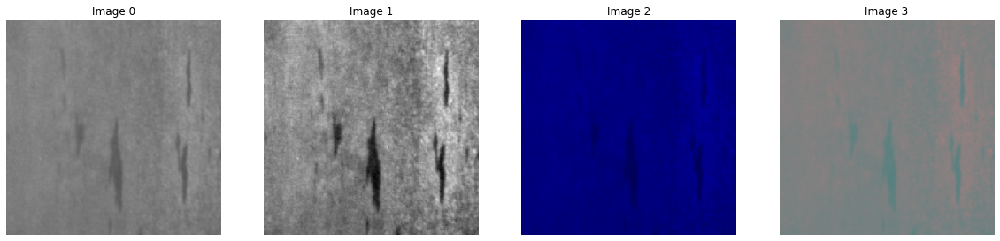

In [14]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('DefectA 03.bmp')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

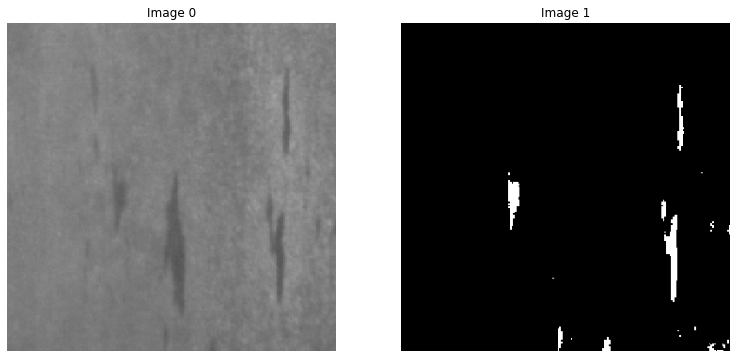

In [15]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 5)
imask = image_index == image_index.max()
mask = SelectMaskByThreshArea(imask, minArea = 0, maxArea = 1000)
ShowImage([image_orig, mask], 1, 3)

<ipython-input-16-f53dbb62ec63>:2: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


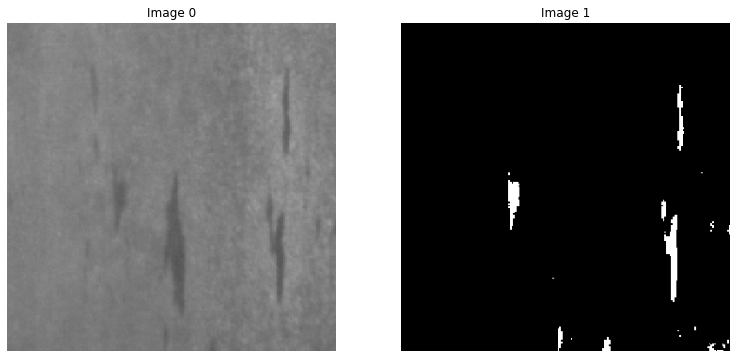

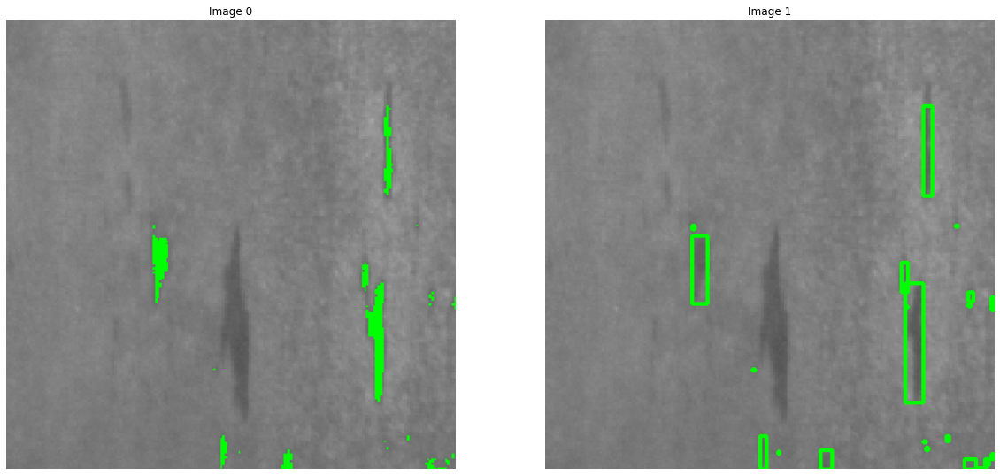

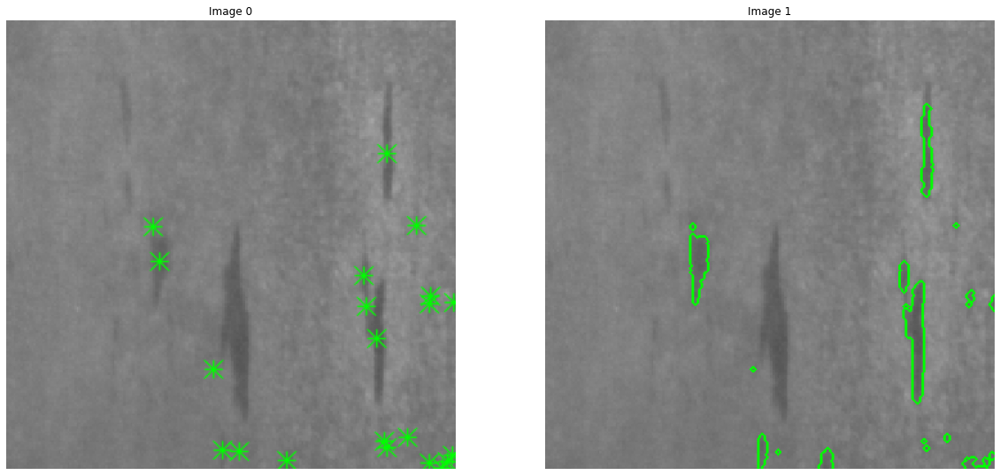

In [16]:
label_img = label(mask)
regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask 
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = (imean > 150) and (imin < 70) and (ratewh > 1.3) and (ratewh < 1.8)
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Vết Defect B

Selected Image :  
Index  25 
Name  DefectB 03.bmp


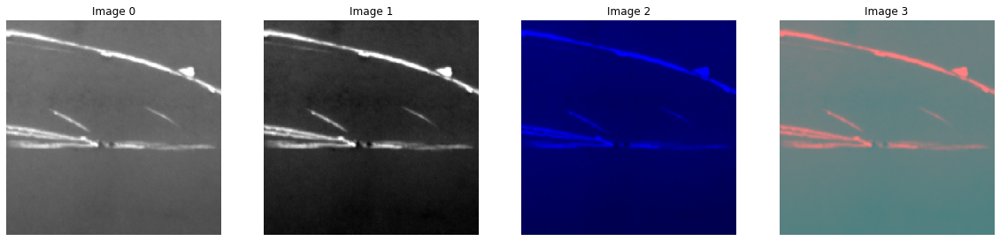

In [17]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('DefectB 03.bmp')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

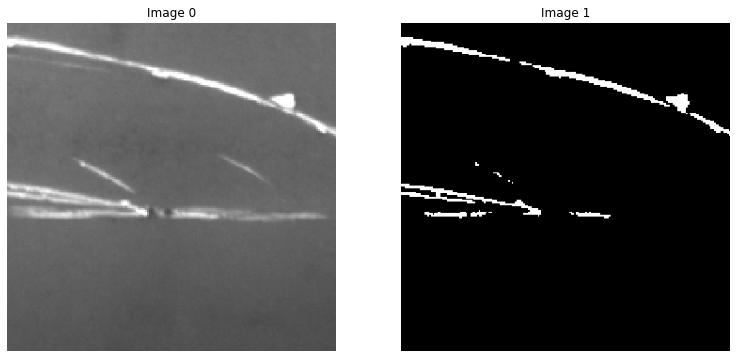

In [18]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 5)
imask = image_index == image_index.max()
mask = SelectMaskByThreshArea(imask, minArea = 0, maxArea = 1000)
ShowImage([image_orig, mask], 1, 3)

<ipython-input-19-f53dbb62ec63>:2: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


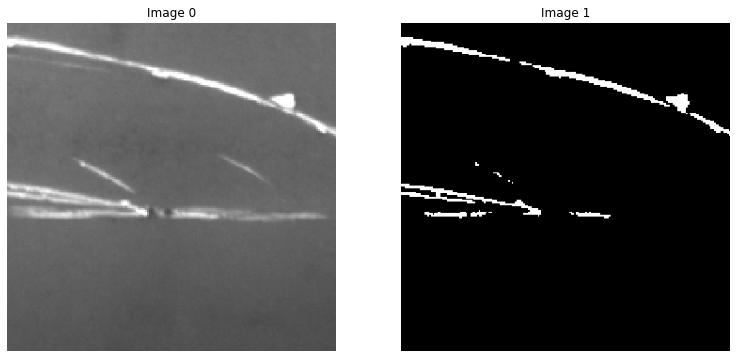

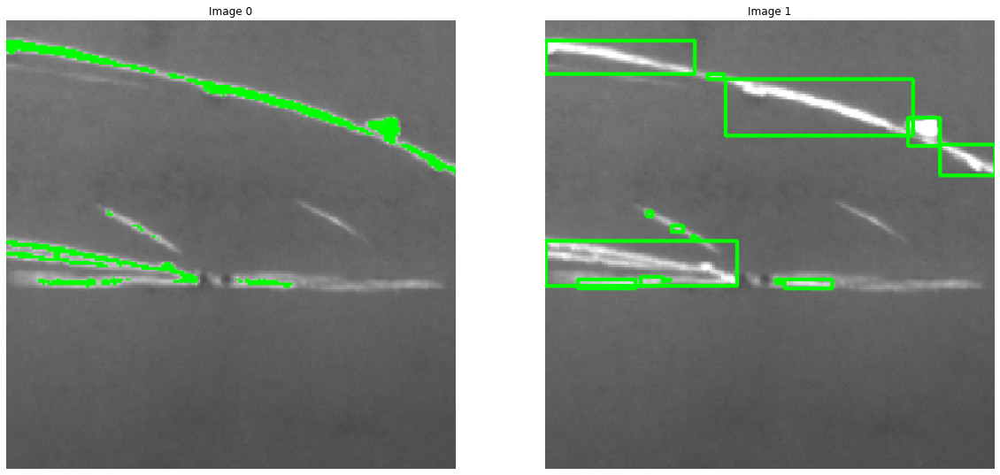

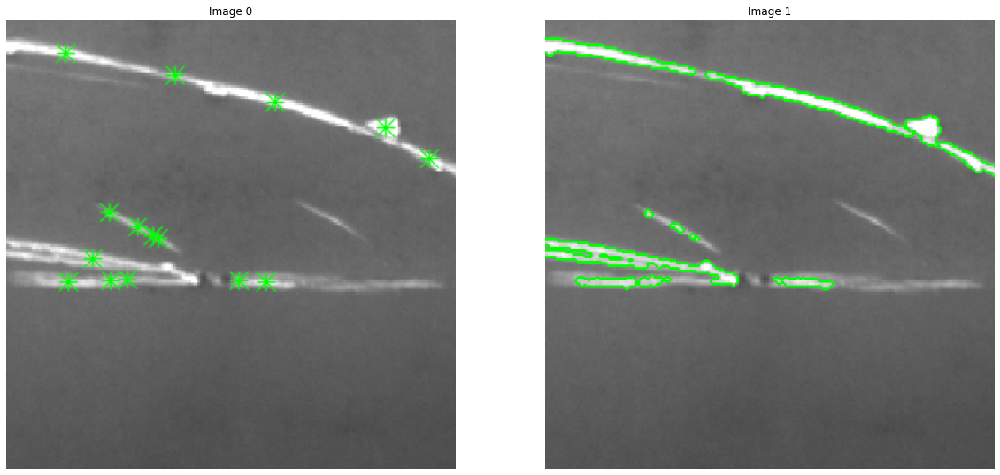

In [19]:
label_img = label(mask)
regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask 
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = (imean > 150) and (imin < 70) and (ratewh > 1.3) and (ratewh < 1.8)
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Biển số xe

Selected Image :  
Index  12 
Name  DrivingPlate 03.jpg


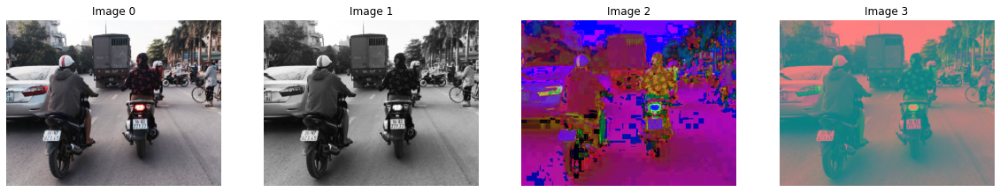

In [20]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('DrivingPlate 03.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

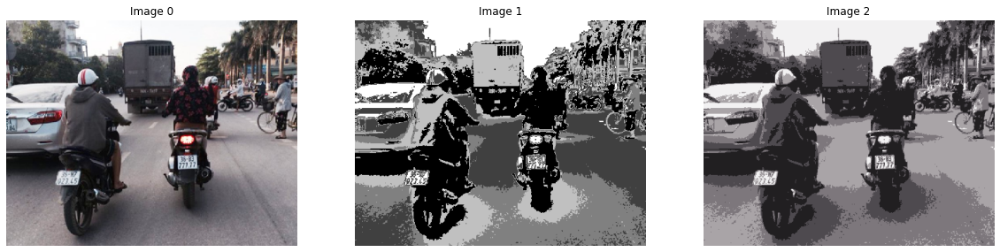

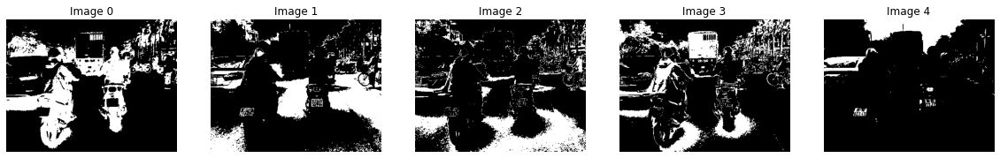

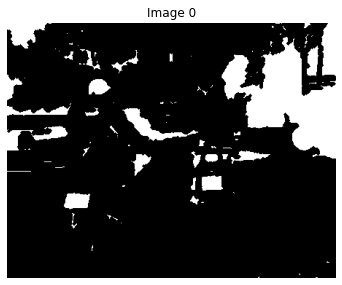

In [21]:
mask_abnormal = Mask(image_orig, image_gray)
mask_abnormal = morphology(mask_abnormal, -2)
ShowImage([mask_abnormal], 1, 3)

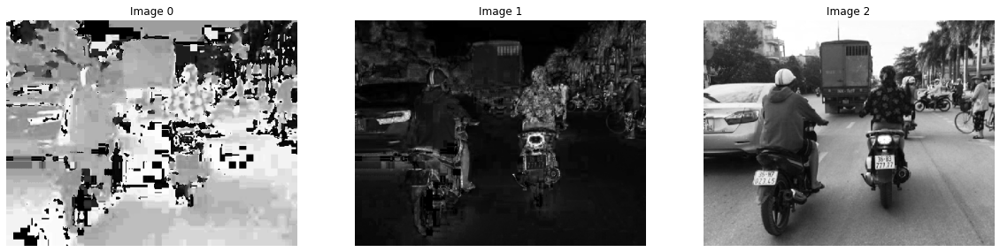

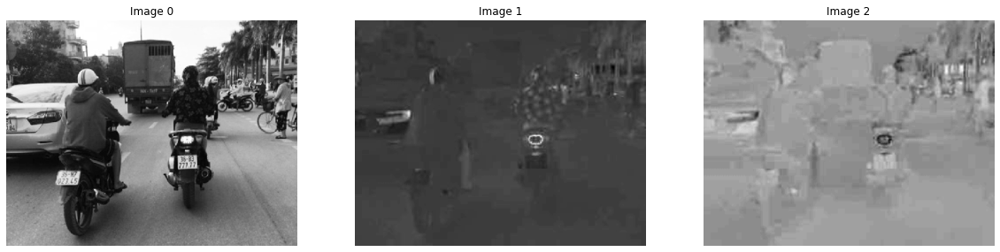

In [22]:
h = image_hsv[:,:,0]
s = image_hsv[:,:,1]
v = image_hsv[:,:,2]
y = image_ycbcr[:,:,0]
cb = image_ycbcr[:,:,1]
cr = image_ycbcr[:,:,2]
ShowImage([h, s, v], 1, 3)
ShowImage([y, cb, cr], 1, 3)

<ipython-input-23-e091836a0a6f>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


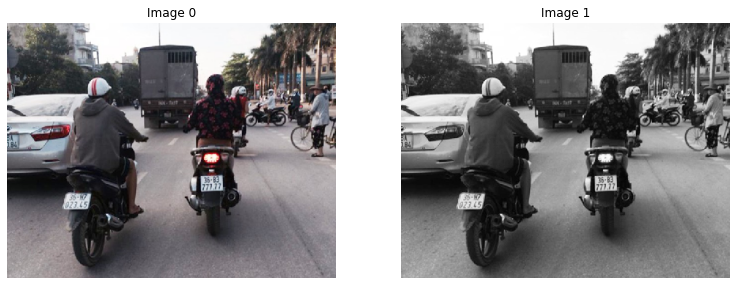

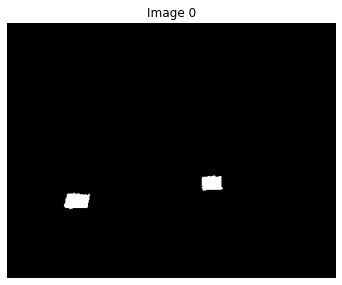

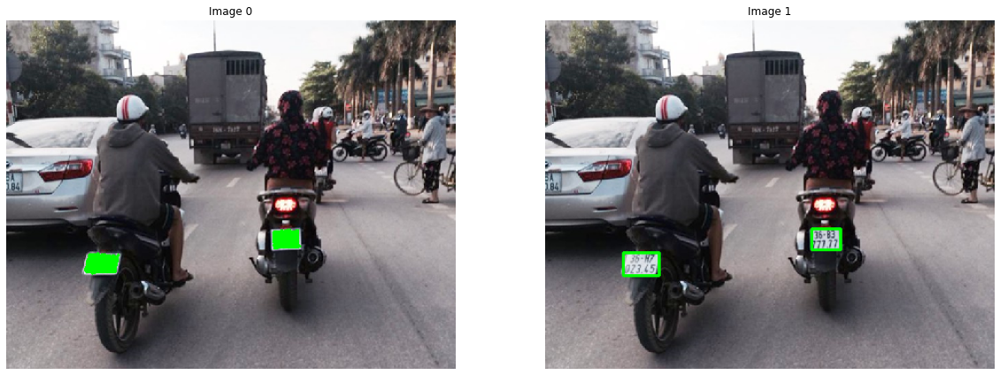

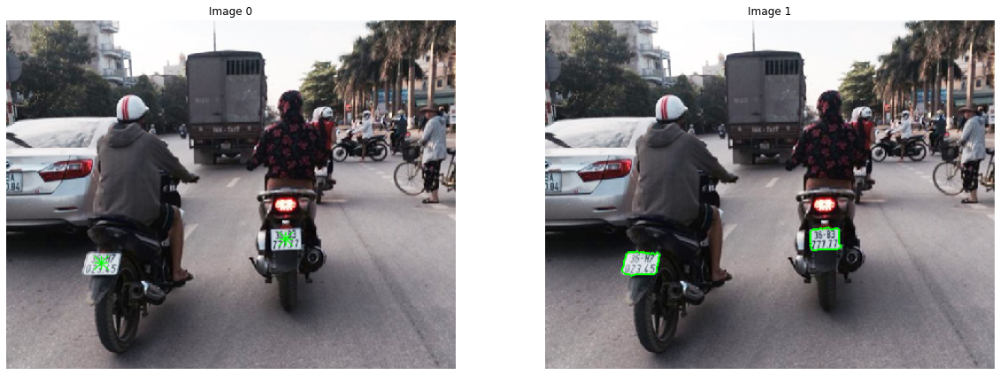

In [23]:
label_img = label(mask_abnormal)

regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask_abnormal * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = (imean > 150) and (imin < 70) and (ratewh > 1.3) and (ratewh < 1.8)
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, y], 1, 3)
ShowImage([mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Vết melanoma trên da

Selected Image :  
Index  16 
Name  Skin 04.jpg


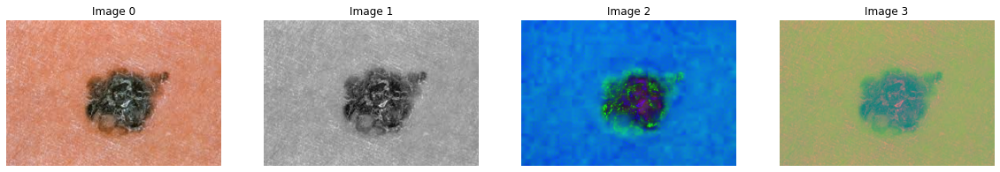

In [54]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('Skin 04.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

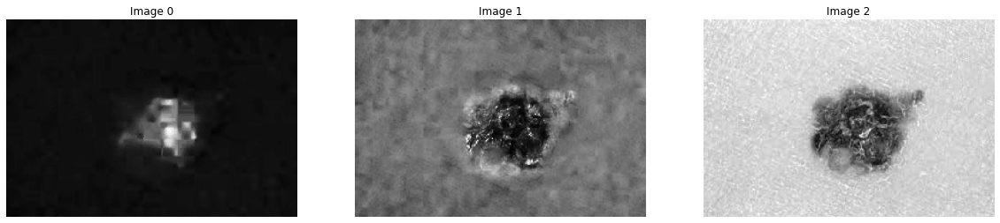

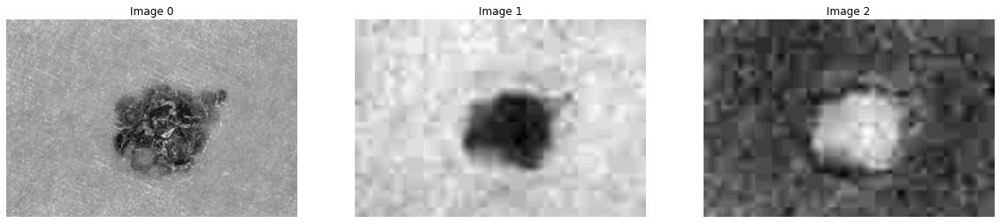

In [55]:
h = image_hsv[:,:,0]
s = image_hsv[:,:,1]
v = image_hsv[:,:,2]
y = image_ycbcr[:,:,0]
cb = image_ycbcr[:,:,1]
cr = image_ycbcr[:,:,2]
ShowImage([h, s, v], 1, 3)
ShowImage([y, cb, cr], 1, 3)

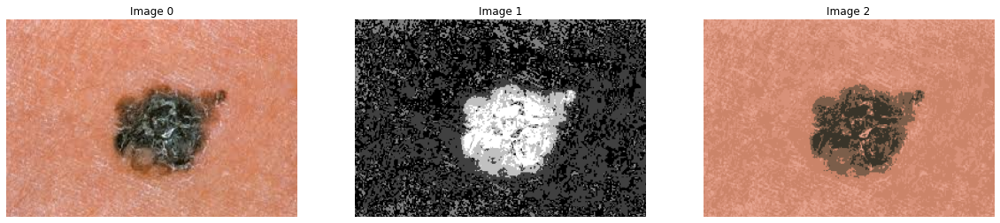

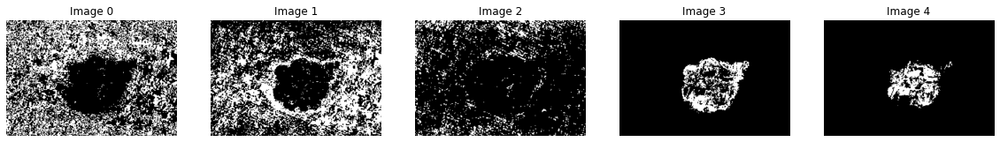

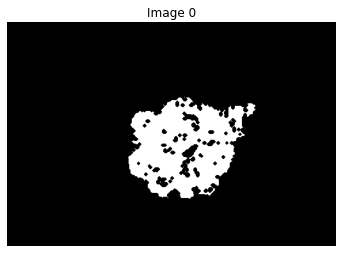

In [56]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 5)

ShowImage([image_orig, image_index, image_kmeans], 1, 3)
mask_list = []
mask_abnormal = image_gray * 0
for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 0, maxArea = 2000)
    mask_list.append(imask)
ShowImage(mask_list, 1, len(mask_list))
mask_abnormal = mask_list[3] + mask_list[4]
mask_abnormal = morphology(mask_abnormal, -2)
ShowImage([mask_abnormal], 1, 3)

<ipython-input-57-a1c9963909d6>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


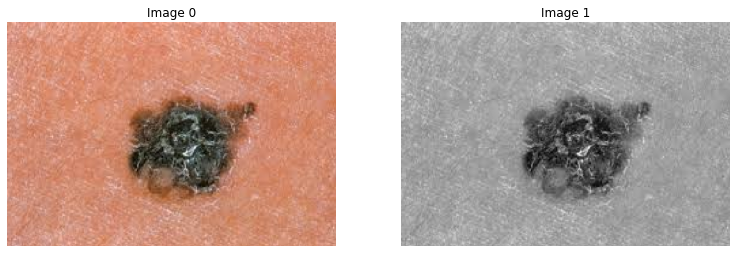

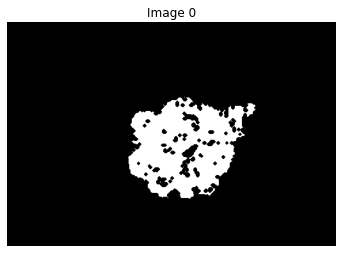

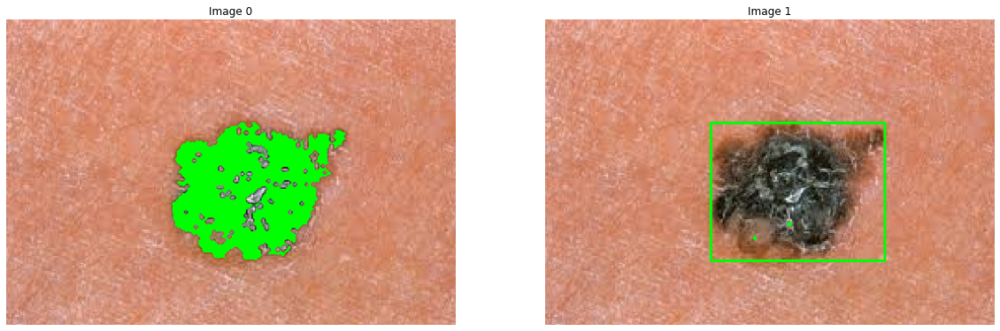

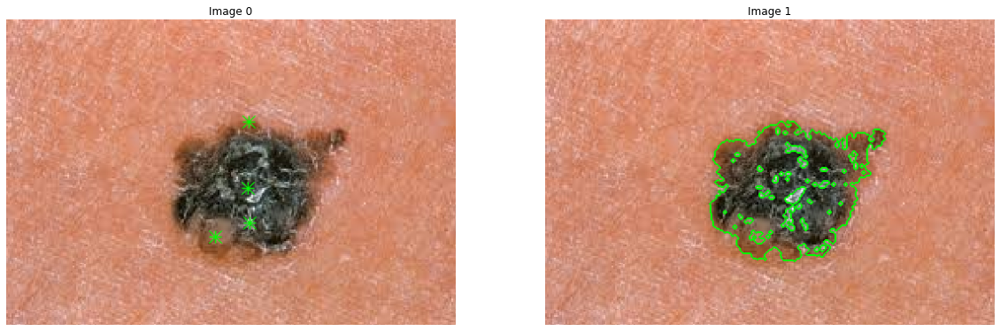

In [57]:
label_img = label(mask_abnormal)

regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask_abnormal 
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = (imean > 150) and (imin < 70) and (ratewh > 1.3) and (ratewh < 1.8)
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, y], 1, 3)
ShowImage([mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Khuôn mặt người 

Selected Image :  
Index  54 
Name  Face 01.jpg


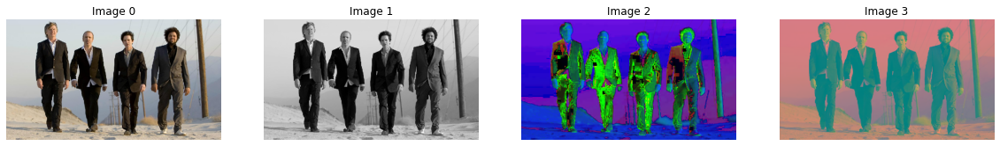

In [28]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('Face 01.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

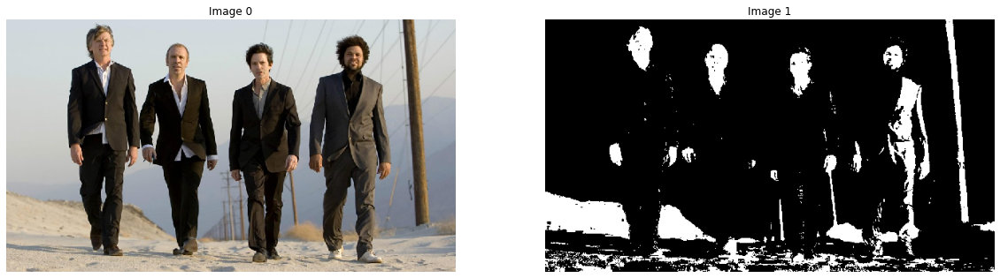

In [29]:
lower = np.array([0, 48, 80], dtype = "uint8")
upper = np.array([20, 255, 255], dtype = "uint8")
skinMask = cv2.inRange(image_hsv, lower, upper)
ShowImage([image_orig, skinMask], 1, 2)

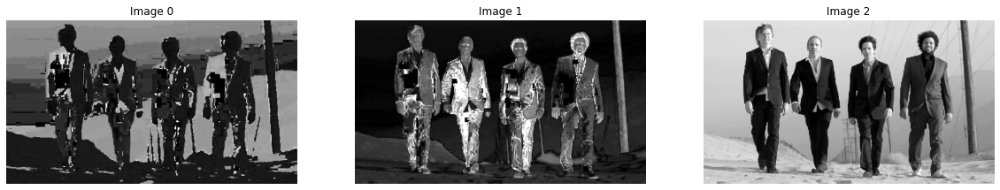

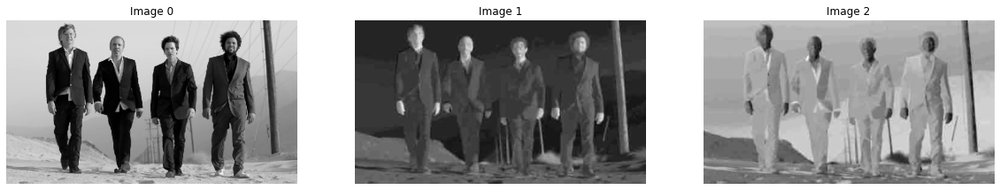

In [30]:
ShowImage([image_hsv[:,:,0],image_hsv[:,:,1], image_hsv[:,:,2]], 1, 3)
ShowImage([image_ycbcr[:,:,0],image_ycbcr[:,:,1], image_ycbcr[:,:,2]], 1, 3)

<ipython-input-31-5332d804d544>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_ycbcr[:,:,1], coordinates='rc')


1311 0.5806451612903226 0.5873655913978495
1426 0.4507042253521127 0.6276408450704225
1213 0.4918032786885246 0.6628415300546449


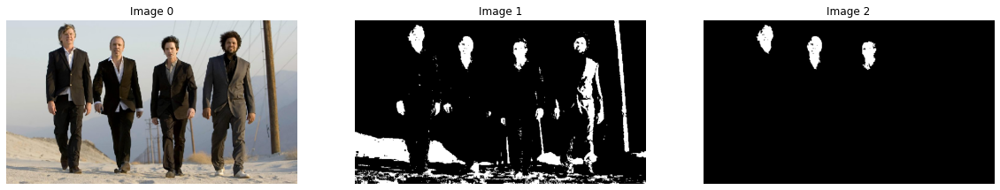

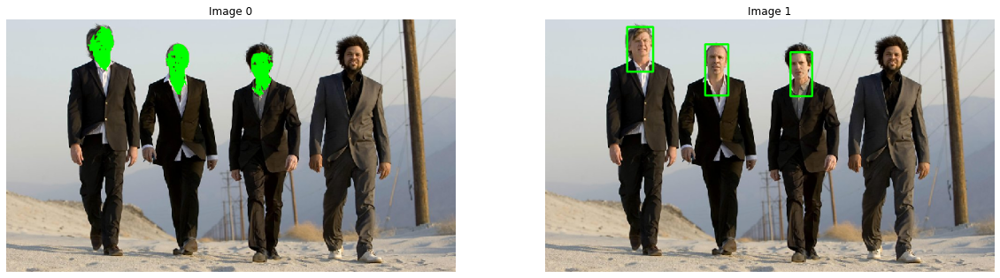

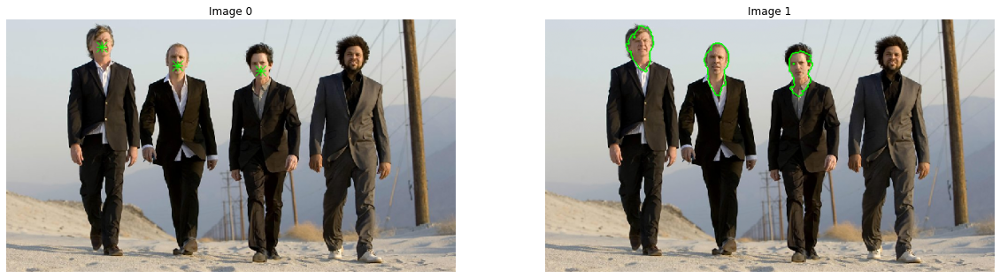

In [31]:
label_img = label(skinMask)

regions = regionprops(label_img, intensity_image= image_ycbcr[:,:,1], coordinates='rc')
mask_condition = skinMask * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    app_std = (imax - imin)/4
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    rateArea = area/ (width * height)
    condition = (area > 1000) and (area < 5000) and (ratewh < 1) and (rateArea > 0.5)
    if(condition):
        mask_condition = mask_condition + (imask).astype(int)
        print(area, ratewh, rateArea)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, skinMask, mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Lửa

Selected Image :  
Index  29 
Name  Fire 03.jpg


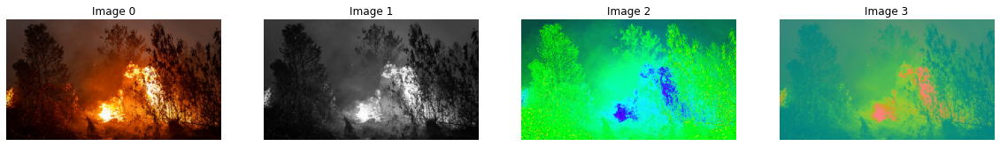

In [32]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('Fire 03.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

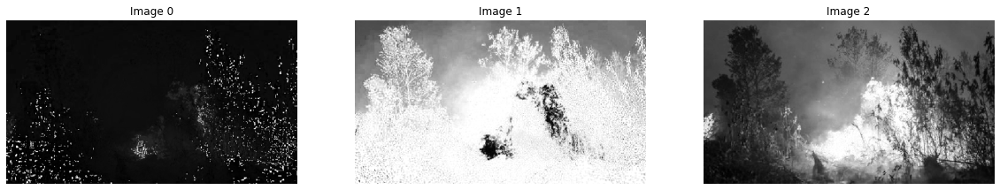

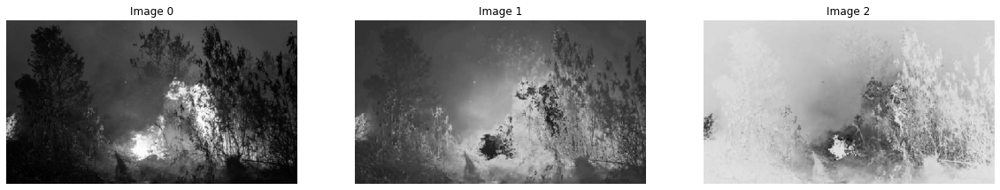

In [33]:
h = image_hsv[:,:,0]
s = image_hsv[:,:,1]
v = image_hsv[:,:,2]
y = image_ycbcr[:,:,0]
cb = image_ycbcr[:,:,1]
cr = image_ycbcr[:,:,2]
ShowImage([h, s, v], 1, 3)
ShowImage([y, cb, cr], 1, 3)

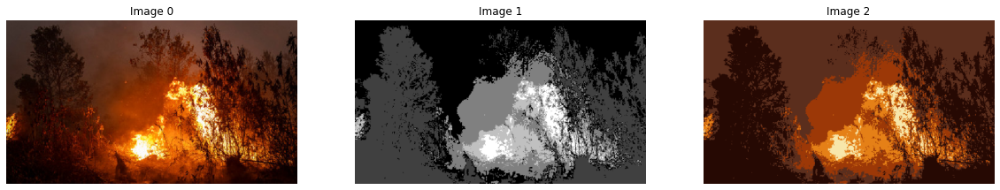

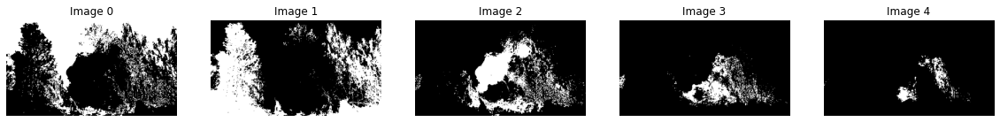

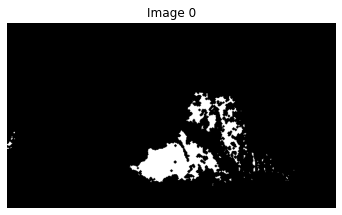

In [34]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 5)

ShowImage([image_orig, image_index, image_kmeans], 1, 3)
mask_list = []
mask_abnormal = image_gray * 0
for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 0, maxArea = 2000)
    mask_list.append(imask)
ShowImage(mask_list, 1, len(mask_list))
mask_abnormal = mask_list[3] + mask_list[4]
mask_abnormal = morphology(mask_abnormal, -2)
ShowImage([mask_abnormal], 1, 3)

<ipython-input-35-a1c9963909d6>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


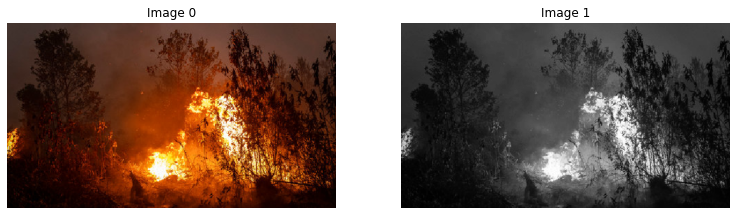

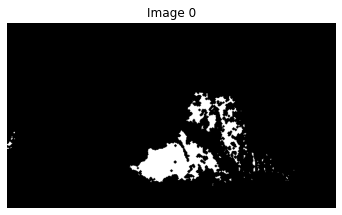

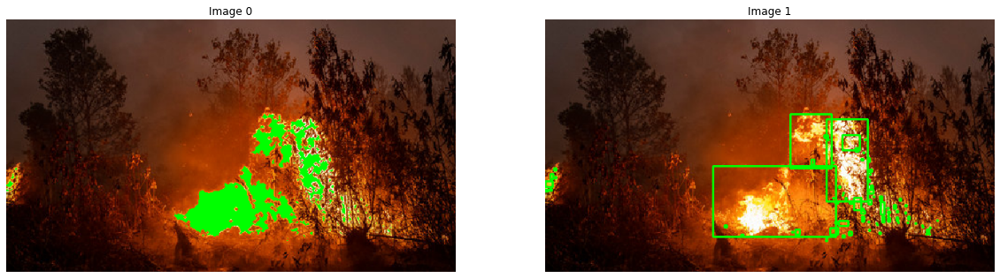

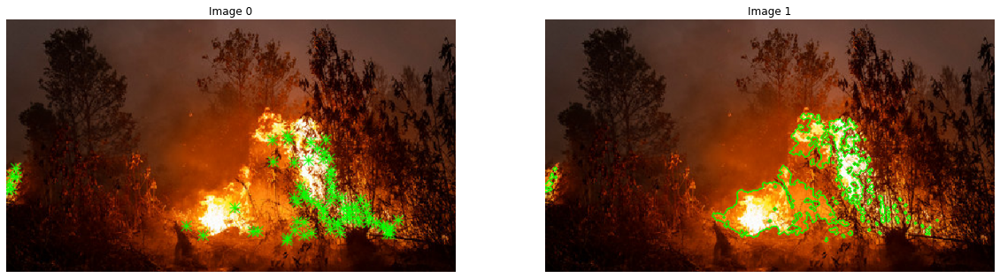

In [35]:
label_img = label(mask_abnormal)

regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask_abnormal 
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = (imean > 150) and (imin < 70) and (ratewh > 1.3) and (ratewh < 1.8)
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, y], 1, 3)
ShowImage([mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Bông hoa

Selected Image :  
Index  19 
Name  Flower 02.jpg


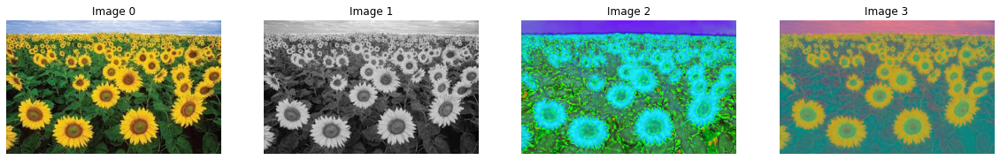

In [36]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('Flower 02.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

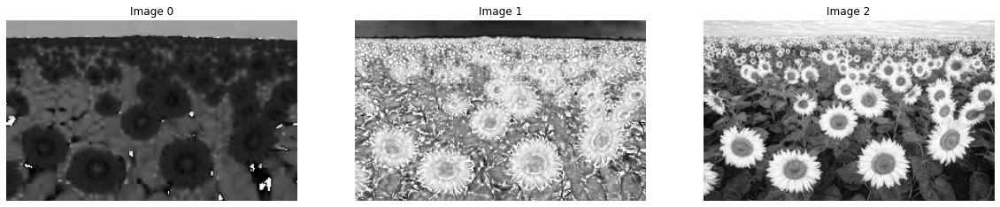

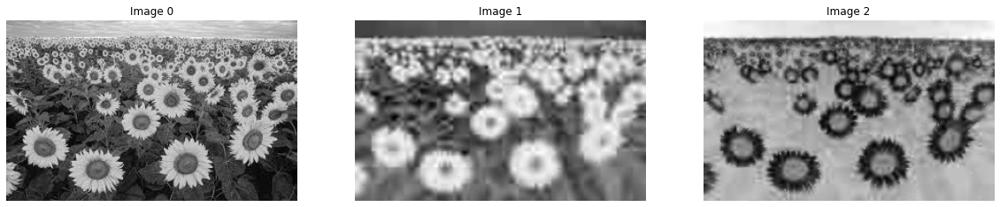

In [37]:
h = image_hsv[:,:,0]
s = image_hsv[:,:,1]
v = image_hsv[:,:,2]
y = image_ycbcr[:,:,0]
cb = image_ycbcr[:,:,1]
cr = image_ycbcr[:,:,2]
ShowImage([h, s, v], 1, 3)
ShowImage([y, cb, cr], 1, 3)

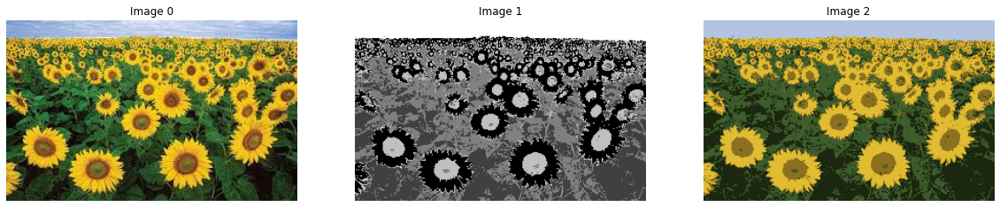

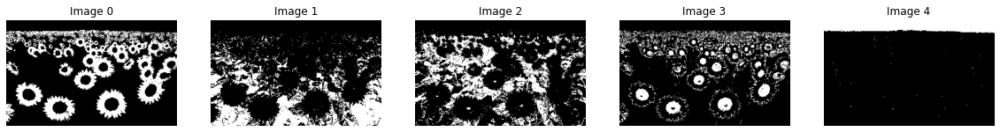

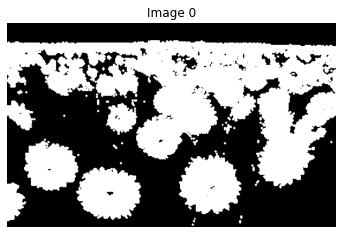

In [38]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 5)

ShowImage([image_orig, image_index, image_kmeans], 1, 3)
mask_list = []
mask_abnormal = image_gray * 0
for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 0, maxArea = 2000)
    mask_list.append(imask)
ShowImage(mask_list, 1, len(mask_list))
mask_abnormal = mask_list[0] + mask_list[3]
mask_abnormal = morphology(mask_abnormal, 1)
ShowImage([mask_abnormal], 1, 3)

<ipython-input-39-a1c9963909d6>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


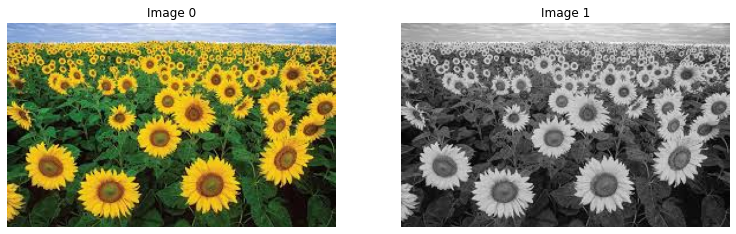

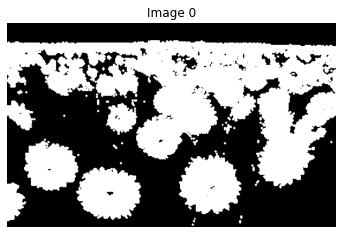

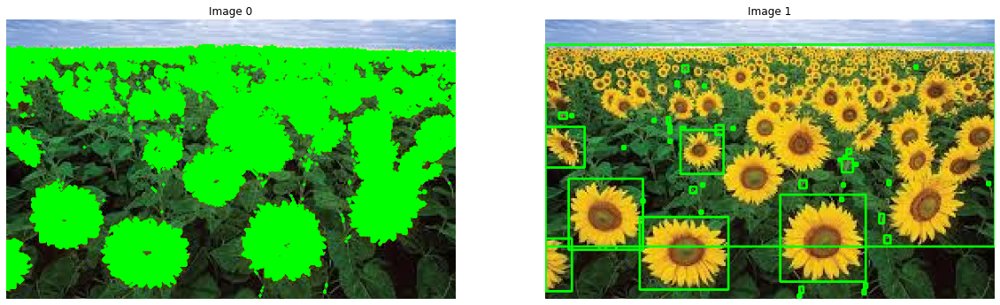

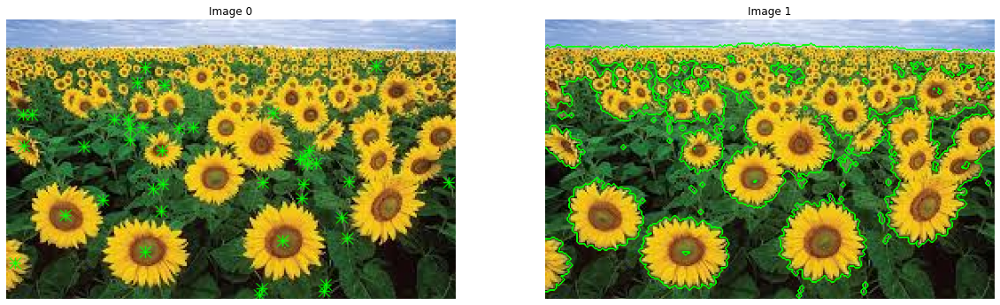

In [39]:
label_img = label(mask_abnormal)

regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask_abnormal 
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = (imean > 150) and (imin < 70) and (ratewh > 1.3) and (ratewh < 1.8)
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, y], 1, 3)
ShowImage([mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Trái bóng

Selected Image :  
Index  41 
Name  Football 01.jpg


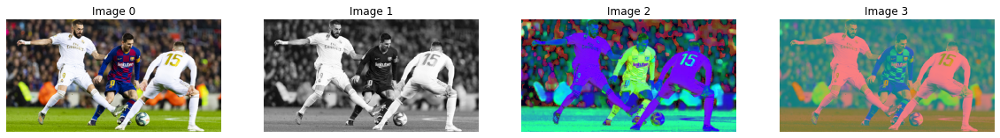

In [40]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('Football 01.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

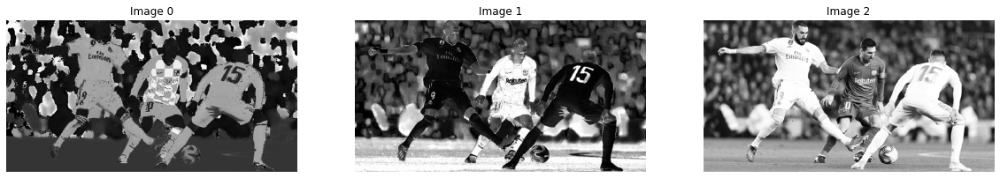

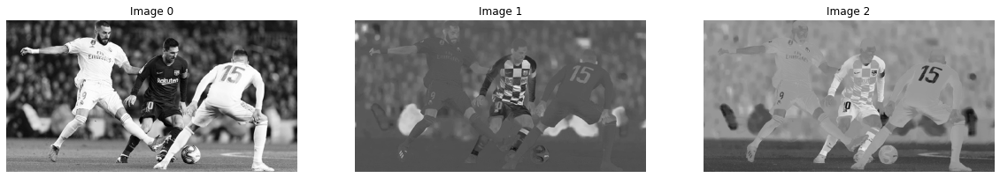

In [41]:
h = image_hsv[:,:,0]
s = image_hsv[:,:,1]
v = image_hsv[:,:,2]
y = image_ycbcr[:,:,0]
cb = image_ycbcr[:,:,1]
cr = image_ycbcr[:,:,2]
ShowImage([h, s, v], 1, 3)
ShowImage([y, cb, cr], 1, 3)

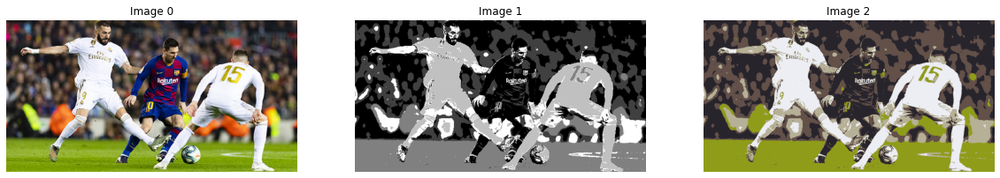

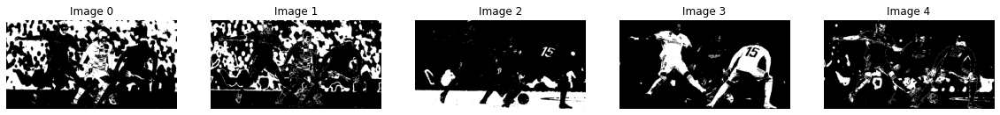

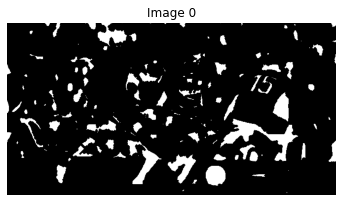

In [42]:
mask_abnormal = Mask(image_orig, image_gray)
mask_abnormal = morphology(mask_abnormal, -2)
ShowImage([mask_abnormal], 1, 3)

<ipython-input-43-9a6e9ae61068>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


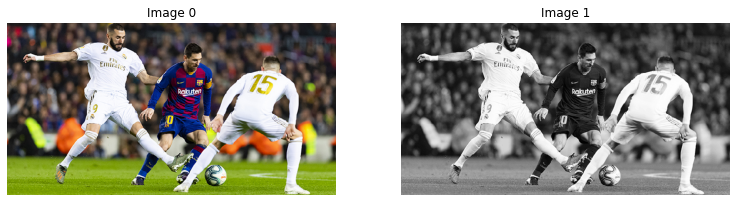

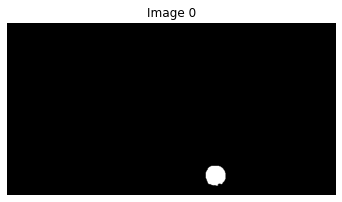

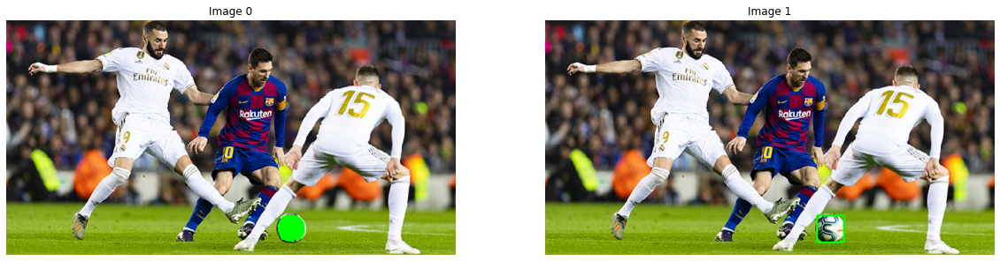

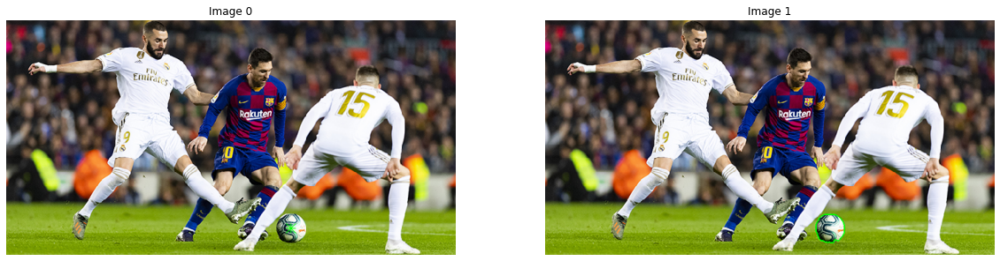

In [43]:
label_img = label(mask_abnormal)

regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask_abnormal * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = width == height
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2 and (area > 500)):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, y], 1, 3)
ShowImage([mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Bàn tay


Selected Image :  
Index  38 
Name  Hand Gesture 01.jpg


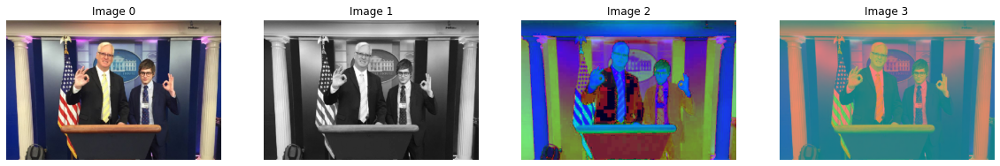

In [44]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('Hand Gesture 01.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

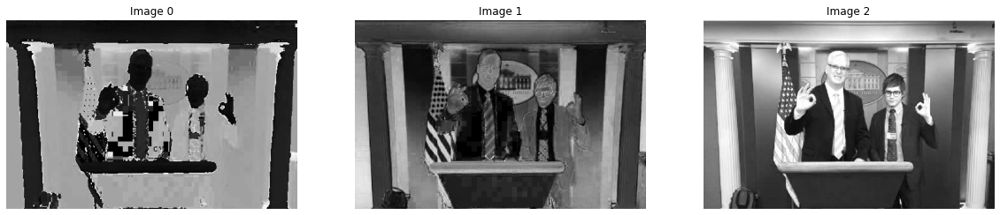

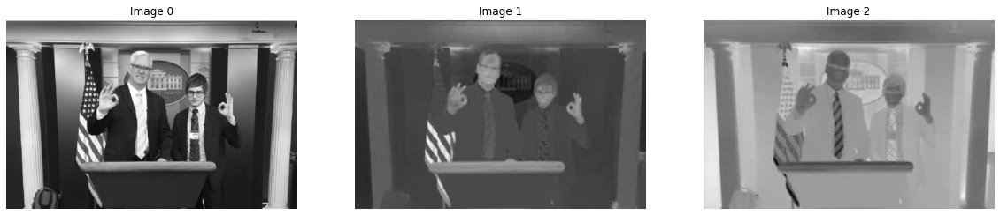

In [45]:
h = image_hsv[:,:,0]
s = image_hsv[:,:,1]
v = image_hsv[:,:,2]
y = image_ycbcr[:,:,0]
cb = image_ycbcr[:,:,1]
cr = image_ycbcr[:,:,2]
ShowImage([h, s, v], 1, 3)
ShowImage([y, cb, cr], 1, 3)

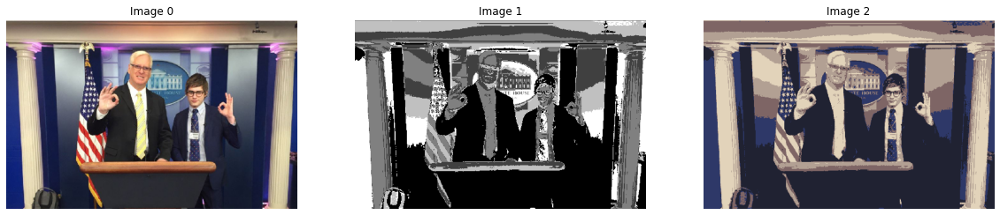

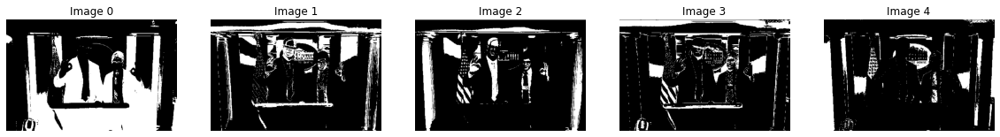

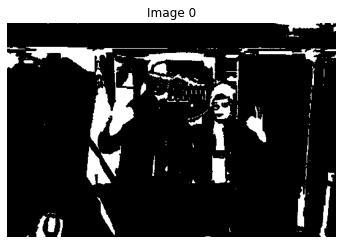

In [46]:
mask_abnormal = Mask(image_orig, image_gray)
mask_abnormal = morphology(mask_abnormal, -1)
ShowImage([mask_abnormal], 1, 3)

<ipython-input-47-7b111a889a3c>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


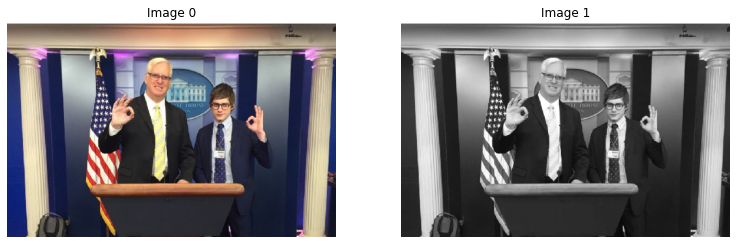

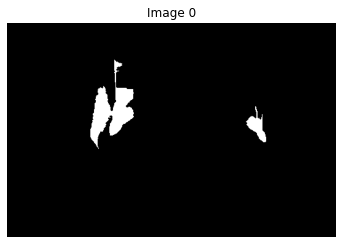

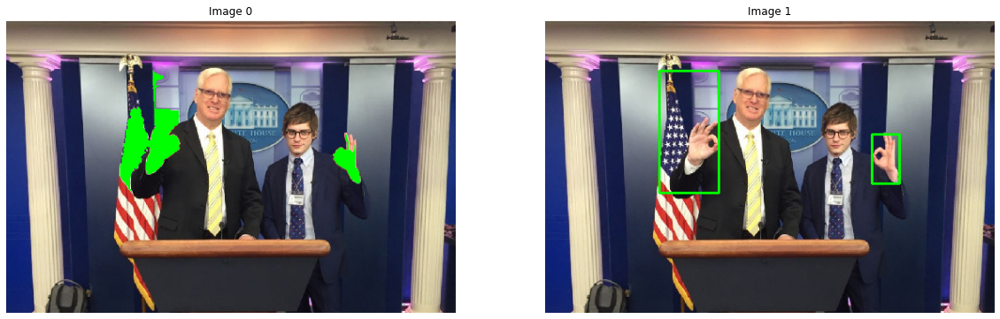

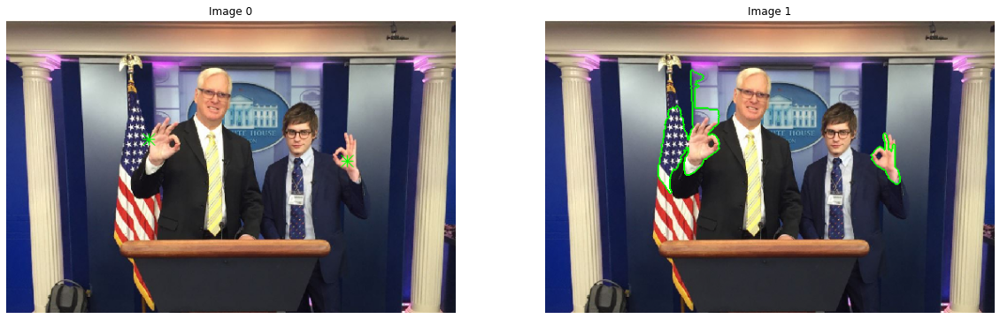

In [47]:
label_img = label(mask_abnormal)

regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask_abnormal * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = (imean > 140) and (imin < 30) and (ratewh > 0.4) and (ratewh < 0.6)
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, y], 1, 3)
ShowImage([mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)

### Vết xuất huyết và xuất tiết

Selected Image :  
Index  45 
Name  Eye 05.jpg


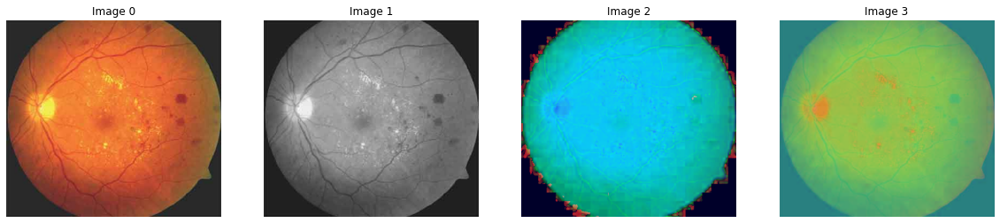

In [48]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('Eye 05.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

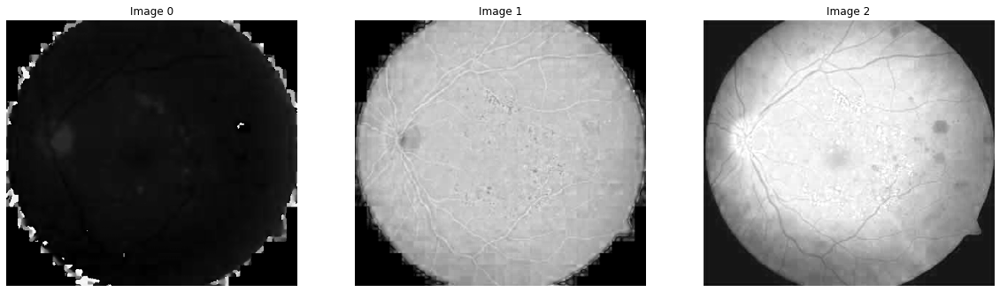

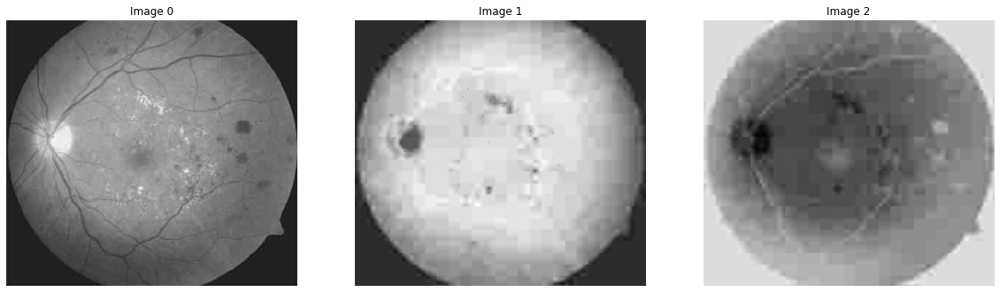

In [49]:
h = image_hsv[:,:,0]
s = image_hsv[:,:,1]
v = image_hsv[:,:,2]
y = image_ycbcr[:,:,0]
cb = image_ycbcr[:,:,1]
cr = image_ycbcr[:,:,2]
ShowImage([h, s, v], 1, 3)
ShowImage([y, cb, cr], 1, 3)

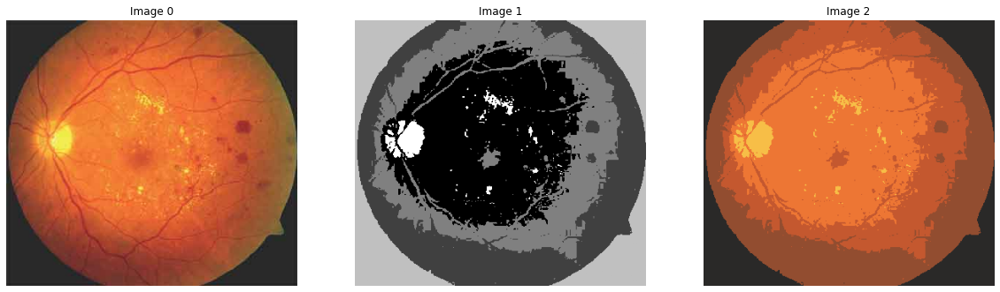

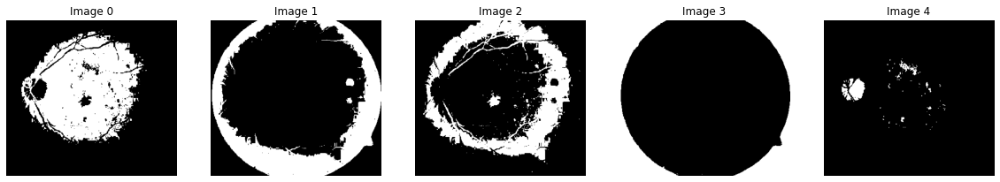

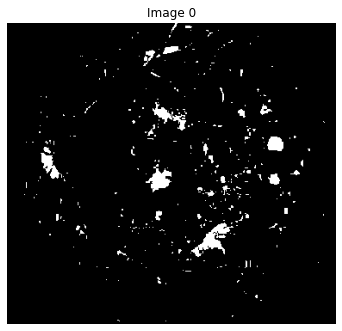

In [50]:
mask_abnormal = Mask(image_orig, image_gray)
ShowImage([mask_abnormal], 1, 3)

<ipython-input-51-165975f692cf>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image=cr, coordinates='rc')


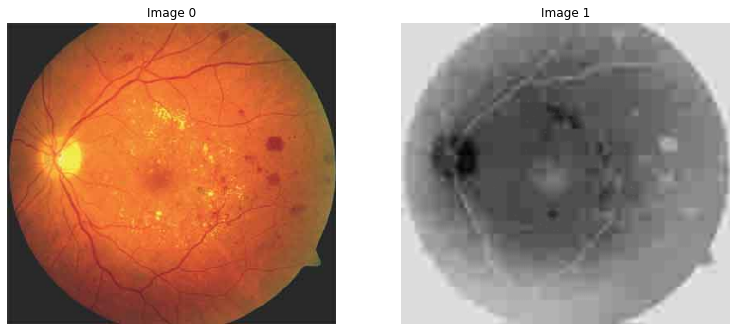

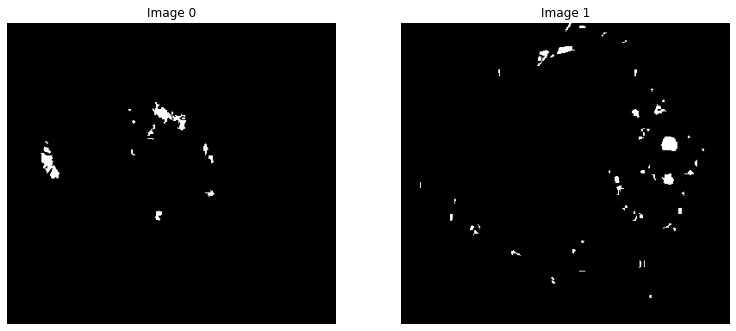

In [51]:
label_img = label(mask_abnormal)

regions = regionprops(label_img, intensity_image=cr, coordinates='rc')
mask_condition1 = mask_abnormal * 0
mask_condition2 = mask_abnormal * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    condition1 = (area > 5) and (area < 5000) and (imean < 70)
    condition2 = (area > 5) and (area < 300) and (imean > 80)
    if(condition1):
        mask_condition1 = mask_condition1 + (imask).astype(int)
    if(condition2):
        mask_condition2 = mask_condition2 + (imask).astype(int)

ShowImage([image_orig, cr], 1, 3)
ShowImage([mask_condition1, mask_condition2], 1, 3)

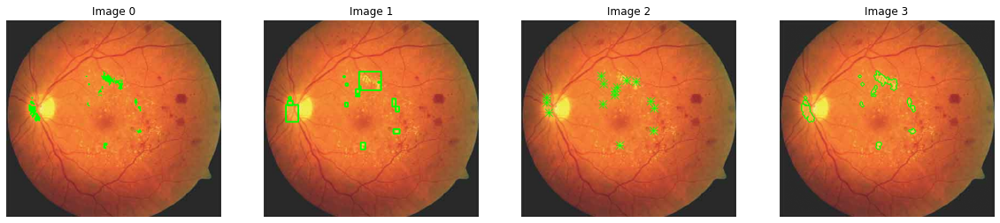

In [52]:
image_output1 = LabelObjectByMask(image_orig, mask_condition1, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition1, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition1, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition1, type = "Boundary", color = (0,255,0), thick =
2)
ShowImage([image_output1, image_output2, image_output3, image_output4], 1, 4)

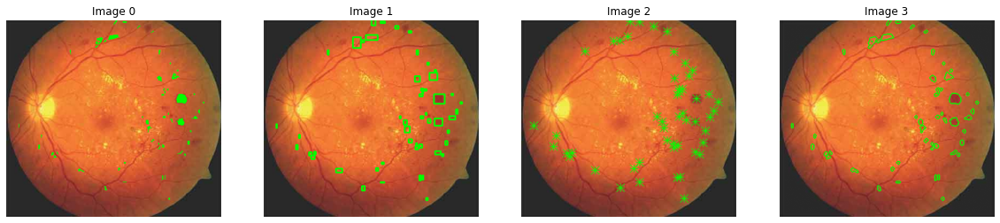

In [53]:
image_output1 = LabelObjectByMask(image_orig, mask_condition2, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition2, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition2, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition2, type = "Boundary", color = (0,255,0), thick =
2)
ShowImage([image_output1, image_output2, image_output3, image_output4], 1, 4)

### Võng mạc

Selected Image :  
Index  4 
Name  Iris 01.jpg


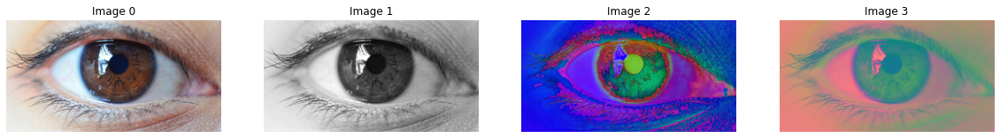

In [58]:
image_orig, image_gray, image_hsv, image_ycbcr = ReadImage('Iris 01.jpg')
ShowImage([image_orig, image_gray, image_hsv, image_ycbcr], 1, 4)

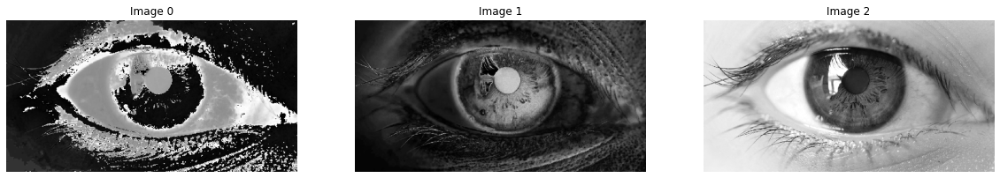

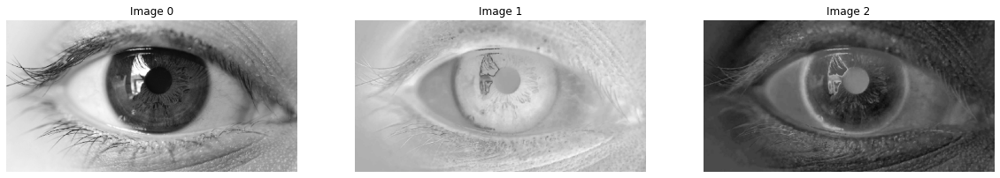

In [59]:
h = image_hsv[:,:,0]
s = image_hsv[:,:,1]
v = image_hsv[:,:,2]
y = image_ycbcr[:,:,0]
cb = image_ycbcr[:,:,1]
cr = image_ycbcr[:,:,2]
ShowImage([h, s, v], 1, 3)
ShowImage([y, cb, cr], 1, 3)

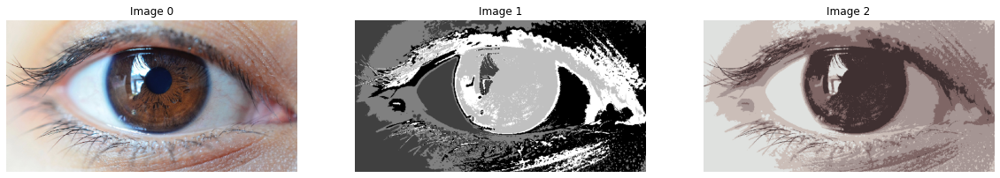

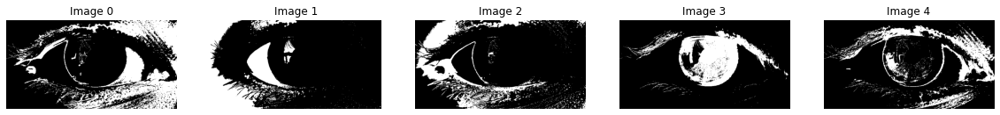

In [78]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 5)

ShowImage([image_orig, image_index, image_kmeans], 1, 3)
mask_list = []
mask_abnormal = image_gray * 0
for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 0, maxArea = 2000)
    mask_list.append(imask)
ShowImage(mask_list, 1, len(mask_list))

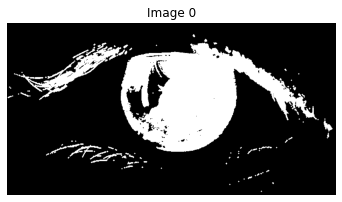

In [114]:
mask = mask_list[3]
mask = morphology(mask, 1)
ShowImage([mask], 1, 3)

<ipython-input-115-c5f27737f2a6>:3: FutureWarning: The coordinates keyword argument to skimage.measure.regionprops is deprecated. All features are now computed in rc (row-column) coordinates. Please remove `coordinates="rc"` from all calls to regionprops before updating scikit-image.
  regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')


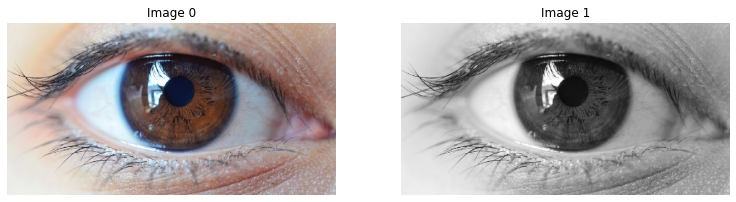

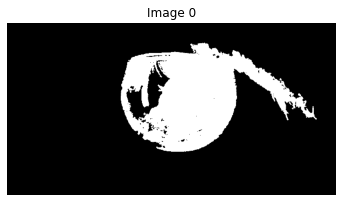

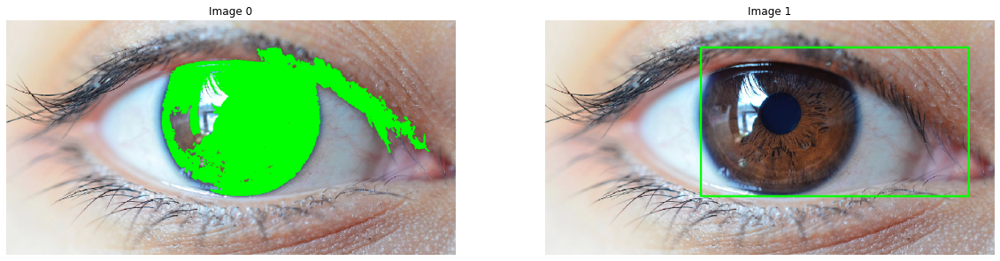

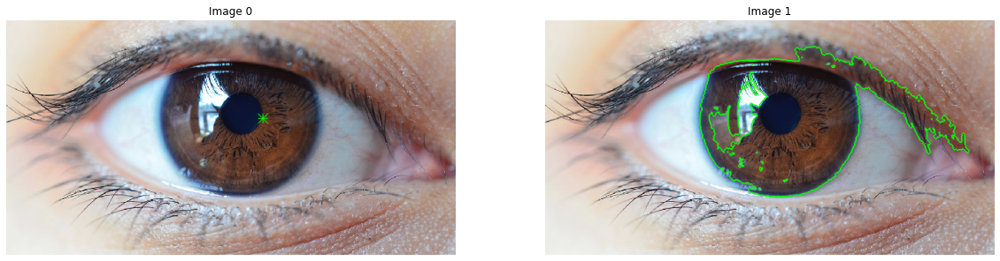

In [115]:
label_img = label(mask)

regions = regionprops(label_img, intensity_image= image_gray, coordinates='rc')
mask_condition = mask * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    minr, minc, maxr, maxc = props.bbox
    width = maxc - minc
    height = maxr - minr
    ratewh = width/height
    condition1 = (imean > 0) and (imin < 50) and (ratewh > 1.3) and (ratewh < 1.8)
    condition2 = props.major_axis_length > 30
    if(condition1 and condition2 and (area > 500)):
        mask_condition = mask_condition + (imask).astype(int)
image_output1 = LabelObjectByMask(image_orig, mask_condition, type = "Fill", color = (0,255,0), thick = 2)
image_output2 = LabelObjectByMask(image_orig, mask_condition, type = "BBox", color = (0,255,0), thick = 2)
image_output3 = LabelObjectByMask(image_orig, mask_condition, type = "Center", color = (0,255,0), thick = 2)
image_output4 = LabelObjectByMask(image_orig, mask_condition, type = "Boundary", color = (0,255,0), thick = 2
)
ShowImage([image_orig, y], 1, 3)
ShowImage([mask_condition], 1, 3)
ShowImage([image_output1, image_output2], 1, 2)
ShowImage([image_output3, image_output4], 1, 2)